<a href="https://colab.research.google.com/github/LucasCarattaOliva/lucascaratta/blob/main/E_commerce_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Importando bibliotecas


In [1]:
import matplotlib.pyplot as plt

In [2]:
from matplotlib import pyplot as plt

In [3]:
import seaborn as sns

In [4]:
import numpy as np


In [5]:
import pandas as pd

Importando documentos



In [6]:
customers = pd.read_csv('olist_customers_dataset.csv')

In [7]:
geolocation = pd.read_csv('olist_geolocation_dataset.csv')

In [8]:
orderitems = pd.read_csv('olist_order_items_dataset.csv')

In [9]:
orderpayments = pd.read_csv('olist_order_payments_dataset.csv')

In [10]:
reviews = pd.read_csv('olist_order_reviews_dataset.csv')

In [11]:
orders = pd.read_csv('olist_orders_dataset.csv')

In [12]:
products = pd.read_csv('olist_products_dataset.csv')

In [13]:
sellers = pd.read_csv('olist_sellers_dataset.csv')

Merging bases de dados


In [14]:
m1 = pd.merge(orders, customers, how = "inner",on = ["customer_id"])

In [15]:
g1 = geolocation.drop_duplicates(subset="geolocation_zip_code_prefix")

In [16]:
m2 = pd.merge(m1, g1 , how = "inner", left_on = 'customer_zip_code_prefix', right_on = 'geolocation_zip_code_prefix')

In [17]:
m3 = pd.merge(m2, orderitems, how = "inner",on = ["order_id"])

In [18]:
m8 = pd.merge(m3,products, how = "inner",on = ["product_id"]) #Mesclando para fazer analise de produtos x categorias x estados

In [19]:
m4 = pd.merge(m3, orderpayments, how = "inner",on = ["order_id"])

In [20]:
m5 = pd.merge(m4, reviews, how = "inner",on = ["order_id"])

In [21]:
m6 = pd.merge(m5,products, how = "inner",on = ["product_id"])

In [22]:
m7 = pd.merge(m6, sellers, how = "inner",on = ["seller_id"])

Informações sobre base dados

In [23]:
m7.duplicated().sum()

0

In [24]:
m7.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'geolocation_zip_code_prefix', 'geolocation_lat',
       'geolocation_lng', 'geolocation_city', 'geolocation_state',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'seller_zip_code_prefix', 

In [25]:
m7.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117998 entries, 0 to 117997
Data columns (total 44 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       117998 non-null  object 
 1   customer_id                    117998 non-null  object 
 2   order_status                   117998 non-null  object 
 3   order_purchase_timestamp       117998 non-null  object 
 4   order_approved_at              117983 non-null  object 
 5   order_delivered_carrier_date   116751 non-null  object 
 6   order_delivered_customer_date  115424 non-null  object 
 7   order_estimated_delivery_date  117998 non-null  object 
 8   customer_unique_id             117998 non-null  object 
 9   customer_zip_code_prefix       117998 non-null  int64  
 10  customer_city                  117998 non-null  object 
 11  customer_state                 117998 non-null  object 
 12  geolocation_zip_code_prefix   

In [26]:
m7.shape

(117998, 44)

Pandas profiling


In [27]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     / 34.6 MB 549 kB/s
     |████████████████████████████████| 10.1 MB 5.2 MB/s 
     |████████████████████████████████| 636 kB 38.4 MB/s 
     |████████████████████████████████| 102 kB 60.4 MB/s 
     |████████████████████████████████| 675 kB 49.9 MB/s 
     |████████████████████████████████| 3.1 MB 61.5 MB/s 
     |████████████████████████████████| 62 kB 801 kB/s 
     |████████████████████████████████| 812 kB 35.1 MB/s 
     |████████████████████████████████| 28.5 MB 48 kB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.0.0-py2.py3-none-any.whl size=248524 sha256=6d9eb57e3746053ef163b1ccea20cce1044bbd75fd7ebcd5c8fcb2fcc02339fd
  Stored in directory: /tmp/pip-ephem-wheel-cache-95k__g2x/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=40034e499ca8196876a456f44b911494e990ed00389a195d12c7a71421f57214
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d

In [28]:
from pandas_profiling import ProfileReport

In [29]:
pr = ProfileReport(m7)

In [30]:
pr                                  

Summarize dataset:   0%|          | 0/57 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

analise exploratoria


Agrupando por média comprada por cidade

In [31]:
geo = m3[['customer_city', 'price', 'freight_value']]

In [32]:
geo = pd.DataFrame(geo)

In [33]:
geo = geo.groupby(by = ['customer_city']).mean() #agrupa por cidade

In [34]:
geo = geo.reset_index()

In [35]:
geo = geo.sort_values(by ='price', ascending= False)

In [36]:
geo = geo[:20]

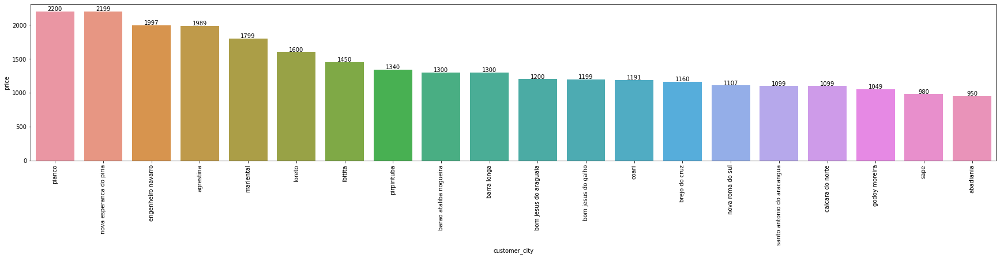

In [37]:
plt.figure(figsize = (30,5))
p1 = sns.barplot(x= 'customer_city',y= 'price', data =geo)
plt.xticks(rotation = 90)

# label each bar in barplot
for p in p1.patches:
 # get the height of each bar
 height = p.get_height()
 # adding text to each bar
 p1.text(x = p.get_x()+(p.get_width()/2), # x-coordinate position of data label, padded to be in the middle of the bar
 y = height+10, # y-coordinate position of data label, padded 100 above bar
 s = '{:.0f}'.format(height), # data label, formatted to ignore decimals
 ha = 'center') # sets horizontal alignment (ha) to center

In [38]:
geo1 = m3[['customer_city', 'price', 'freight_value']]

In [39]:
geo1 = pd.DataFrame(geo1)

In [40]:
geo1 = geo1.groupby(by = geo1['customer_city']).sum()

In [41]:
geo1 = geo1.sort_values(by ='price' ,ascending= False)

In [42]:
geo1 = geo1.reset_index()

In [43]:
geo1 = geo1[:20]

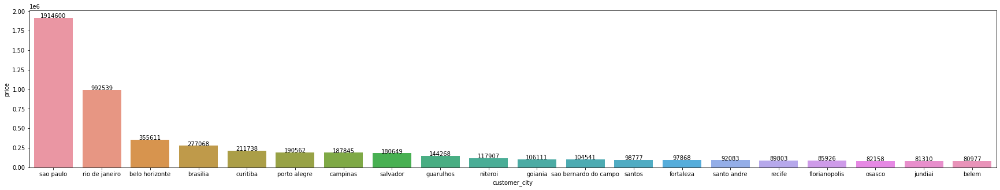

In [44]:
plt.figure(figsize = (30,5))
p2 = sns.barplot(x= 'customer_city',y= 'price', data =geo1)
# label each bar in barplot
for p in p2.patches:
 # get the height of each bar
 height = p.get_height()
 # adding text to each bar
 p2.text(x = p.get_x()+(p.get_width()/2), # x-coordinate position of data label, padded to be in the middle of the bar
 y = height+10, # y-coordinate position of data label, padded 100 above bar
 s = '{:.0f}'.format(height), # data label, formatted to ignore decimals
 ha = 'center') # sets horizontal alignment (ha) to center

In [45]:
#Número de pessoas cadastradas em Uberlândia?

In [46]:
m7ULA = m3[m3.customer_city =="uberlandia"]

In [47]:
m7ULA.groupby('customer_city').nunique()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
customer_city,,,,,,,,,,,,,,,,,,,,,,
uberlandia,372,372,4,372,372,368,367,226,365,15,1,15,15,15,2,1,4,360,241,373,261,267


In [48]:
customers[customers.customer_city == "uberlandia"].nunique()

customer_id                 374
customer_unique_id          367
customer_zip_code_prefix     15
customer_city                 1
customer_state                1
dtype: int64

In [49]:
#Quais as categorias que mais venderam?

In [50]:
cat= pd.merge(orders,orderitems, how = "inner",on = ["order_id"])
cat = pd.merge(cat, products, how = "inner", on =["product_id"])

In [51]:
cat = cat[['product_category_name', 'price']]

In [52]:
cat = cat.groupby('product_category_name',as_index=False).agg(['sum', 'count'])

In [53]:
cat = pd.DataFrame(cat)

In [54]:
cat = cat.reset_index()


In [55]:
cat.columns = cat.columns.get_level_values(0)


In [56]:
cat = cat.set_axis(['product_category_name', 'sum_price', 'count_price'], axis=1, inplace=False)

In [57]:
cat = cat.sort_values(by = 'sum_price', ascending = False)
cat = cat[:20]
cat1 = cat.sort_values(by = 'count_price', ascending = False)
cat1 = cat1[:20]

[Text(0, 0, 'beleza_saude'),
 Text(0, 0, 'relogios_presentes'),
 Text(0, 0, 'cama_mesa_banho'),
 Text(0, 0, 'esporte_lazer'),
 Text(0, 0, 'informatica_acessorios'),
 Text(0, 0, 'moveis_decoracao'),
 Text(0, 0, 'cool_stuff'),
 Text(0, 0, 'utilidades_domesticas'),
 Text(0, 0, 'automotivo'),
 Text(0, 0, 'ferramentas_jardim'),
 Text(0, 0, 'brinquedos'),
 Text(0, 0, 'bebes'),
 Text(0, 0, 'perfumaria'),
 Text(0, 0, 'telefonia'),
 Text(0, 0, 'moveis_escritorio'),
 Text(0, 0, 'papelaria'),
 Text(0, 0, 'pcs'),
 Text(0, 0, 'pet_shop'),
 Text(0, 0, 'instrumentos_musicais'),
 Text(0, 0, 'eletroportateis')]

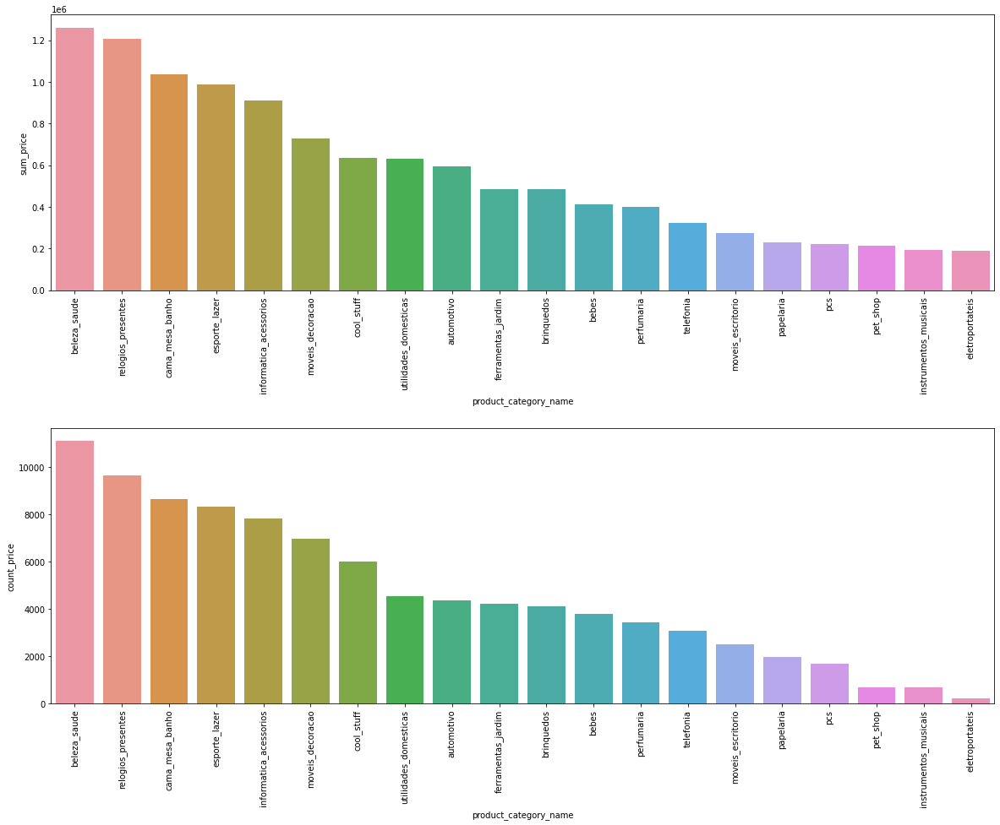

In [58]:
fig,axes= plt.subplots(2, 1, figsize=(20, 15))

f1 = sns.barplot(ax = axes[0],  x = 'product_category_name', y='sum_price', data = cat)
f2 = sns.barplot(ax = axes[1],  x = 'product_category_name', y='count_price', data = cat1)
plt.subplots_adjust(hspace = 0.5)
#lt.xticks(rotation = 90)
f1.set_xticklabels(cat['product_category_name'].tolist(), rotation = 90)
f2.set_xticklabels(cat['product_category_name'].tolist(), rotation = 90)




In [59]:
#Quais as categorias que mais venderam por estados que mais venderam?

In [60]:
cat2 = m8.groupby(['product_category_name', 'customer_state']).agg(['sum', 'count'])

In [61]:
cat3 = m8.groupby([ 'customer_state', 'product_category_name']).agg(['sum', 'count'])

In [62]:
cat2 = cat2['price']

In [63]:
cat3 = cat3['price']

In [64]:
cat2 = cat2.sort_values(by = 'sum')

In [65]:
cat3 = cat3.sort_values(by = 'sum')

In [66]:
cat2 = cat2.tail(20)

In [67]:
cat2 = pd.DataFrame(cat2)

In [68]:
cat2 = cat2.reset_index()
cat2.columns = cat2.columns.get_level_values(0)
cat2 = cat2.set_axis(['product_category_name', 'customer_state','sum_price', 'count_price'], axis=1, inplace=False)

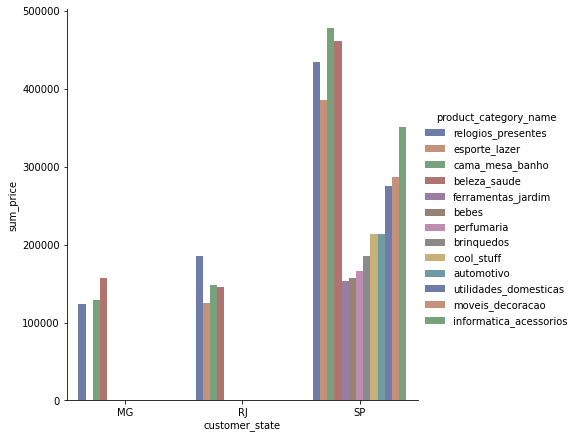

In [69]:
g = sns.catplot(
    data=cat2, kind="bar",
    x="customer_state", y="sum_price", hue="product_category_name",
    ci="sd", palette="dark", alpha=.6, height=6
)

Analise de Clusters

In [70]:
#analise de cluster de produtos por dimensões

In [71]:
!pip install plotly --upgrade

     |████████████████████████████████| 21.8 MB 67.3 MB/s 
  Attempting uninstall: plotly
    Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [72]:
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
from sklearn.preprocessing import StandardScaler

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


In [73]:
from sklearn.cluster import KMeans

In [74]:
produtos = pd.DataFrame(products)

In [75]:
produtos = produtos[["product_height_cm", "product_length_cm"]]

In [76]:
produtos = pd.DataFrame(produtos)

In [77]:
grafico = px.scatter(x = produtos['product_height_cm'], y = produtos['product_length_cm'])
grafico.show() #plotando dispersão de altura x comprimento

In [78]:
#Limpando base de dados para dados "infinitos"
def clean_dataset(df):
    assert isinstance(df, pd.DataFrame), "df needs to be a pd.DataFrame"
    df.dropna(inplace=True)
    indices_to_keep = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
    return df[indices_to_keep].astype(np.float64)

In [79]:
clean_dataset(produtos) # Limpando dataset

,product_height_cm,product_length_cm
0,10.0,16.0
1,18.0,30.0
2,9.0,18.0
3,4.0,26.0
4,17.0,20.0
...,...,...
32946,40.0,40.0
32947,19.0,16.0
32948,7.0,27.0
32949,13.0,31.0


In [80]:
scaler_produtos = StandardScaler()
produtos = scaler_produtos.fit_transform(produtos) #padronizando

In [81]:
produtos

array([[-0.50872513, -0.87589579],
       [ 0.07789922, -0.04818896],
       [-0.58205318, -0.75765196],
       ...,
       [-0.72870927, -0.22555471],
       [-0.288741  ,  0.01093295],
       [-1.09534949, -1.11238346]])

In [82]:
kmeans_produtos= KMeans (n_clusters=10)
kmeans_produtos.fit(produtos) #aplicando KMeans

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=10, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [83]:
centroides = kmeans_produtos.cluster_centers_
centroides #localização dos centroides

array([[-7.89668727e-01, -6.93551279e-01],
       [ 2.00034527e+00, -2.04864818e-03],
       [-3.63195639e-01,  1.70072976e+00],
       [ 4.68036058e+00,  3.44195598e-01],
       [-3.53997124e-01,  3.62607348e+00],
       [ 6.89833646e-01, -2.91015973e-01],
       [-5.01500631e-01,  3.11664588e-01],
       [-1.20136379e-01, -6.70376751e-01],
       [ 6.83841730e-01,  9.15403135e-01],
       [ 2.59928499e+00,  1.87518294e+00]])

In [84]:
centroides1= scaler_produtos.inverse_transform(kmeans_produtos.cluster_centers_) #despadronizando dados

In [85]:
centroides1

array([[ 6.1686747 , 19.08421185],
       [44.21706399, 30.7804266 ],
       [11.98463624, 59.58156349],
       [80.76536313, 36.63687151],
       [12.11007958, 92.14721485],
       [26.34516211, 25.89277508],
       [10.09852305, 36.08663545],
       [15.29931973, 19.47619048],
       [26.26344828, 46.2983908 ],
       [52.38501292, 62.53229974]])

In [86]:
centroides1 = pd.DataFrame(centroides1, columns = ['height', 'lenght'])

In [87]:
grafico1 = px.scatter(x = centroides1['height'], y = centroides1['lenght'])
grafico1.show()

In [88]:
rotulos = kmeans_produtos.labels_

In [89]:
rotulos

array([0, 7, 0, ..., 0, 6, 0], dtype=int32)

In [90]:
grafico3 = px.scatter(x=produtos[:,0], y = produtos[:,1], color = rotulos)
grafico4 = px.scatter(x=centroides[:,0], y = centroides[:,1], size = [12,12,12,12,12,12,12,12,12,12])
grafico5 = go.Figure(data=  grafico4.data + grafico3.data )
grafico5.show()

In [91]:
wcss = []
 
for i in range(1, 20):
    kmeans = KMeans(n_clusters = i, random_state = 0)
    kmeans.fit(produtos)
    print (i,kmeans.inertia_)
    wcss.append(kmeans.inertia_)  



1 65898.0
2 39479.147723969705
3 25666.552505753552
4 19656.664353071297
5 15311.184030400293
6 12895.542560822674
7 11179.297507113328
8 9763.725359364575
9 8571.811786478253
10 7718.181474581172
11 6908.987076669813
12 6332.128240059701
13 5839.709276548417
14 5401.871070564052
15 5023.932206214913
16 4700.023941298158
17 4464.546251734836
18 4159.834152685209
19 3968.8160887631875


In [92]:
gr = px.line(x = range(1, 20), y = wcss, title = "Método Elbow")
gr.update_layout(xaxis_title = "Número de Clusters", yaxis_title= "Distância dentro dos clusters")
gr.show()

In [93]:
p = pd.DataFrame(products)

In [94]:
p.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [95]:
p1 = p.product_category_name.unique()

In [96]:
p1= pd.DataFrame(p1)

In [97]:
#clusterização de clientes por hábitos de consumo


In [98]:
df1= pd.merge(orders,orderitems, how = "inner",on = ["order_id"])

In [99]:
df1 = pd.merge(df1, products, how = "inner", on =["product_id"])

In [100]:
df1 = df1[['customer_id','product_category_name', 'price']]

In [101]:
df1.head()

,customer_id,product_category_name,price
0,9ef432eb6251297304e76186b10a928d,utilidades_domesticas,29.99
1,a20e8105f23924cd00833fd87daa0831,utilidades_domesticas,29.99
2,26c7ac168e1433912a51b924fbd34d34,utilidades_domesticas,29.99
3,53904ddbea91e1e92b2b3f1d09a7af86,utilidades_domesticas,29.99
4,b0830fb4747a6c6d20dea0b8c802d7ef,perfumaria,118.70


In [102]:
df1 = df1.groupby(['customer_id', 'product_category_name']).sum()

In [103]:
df1 = pd.DataFrame(df1)

In [104]:
df1.head()

,,price
customer_id,product_category_name,
00012a2ce6f8dcda20d059ce98491703,brinquedos,89.80
000161a058600d5901f007fab4c27140,beleza_saude,54.90
0001fd6190edaaf884bcaf3d49edf079,bebes,179.99
0002414f95344307404f0ace7a26f1d5,cool_stuff,149.90
000379cdec625522490c315e70c7a9fb,cama_mesa_banho,93.00


In [105]:
df2 = pd.pivot_table(df1,values = 'price', index = ['customer_id'], columns = ['product_category_name'], aggfunc =np.sum ).fillna(0)

In [106]:
df2.head()

product_category_name,agro_industria_e_comercio,alimentos,alimentos_bebidas,artes,artes_e_artesanato,artigos_de_festas,artigos_de_natal,audio,automotivo,bebes,bebidas,beleza_saude,brinquedos,cama_mesa_banho,casa_conforto,casa_conforto_2,casa_construcao,cds_dvds_musicais,cine_foto,climatizacao,consoles_games,construcao_ferramentas_construcao,construcao_ferramentas_ferramentas,construcao_ferramentas_iluminacao,construcao_ferramentas_jardim,construcao_ferramentas_seguranca,cool_stuff,dvds_blu_ray,eletrodomesticos,eletrodomesticos_2,eletronicos,eletroportateis,esporte_lazer,fashion_bolsas_e_acessorios,fashion_calcados,fashion_esporte,fashion_roupa_feminina,fashion_roupa_infanto_juvenil,fashion_roupa_masculina,fashion_underwear_e_moda_praia,ferramentas_jardim,flores,fraldas_higiene,industria_comercio_e_negocios,informatica_acessorios,instrumentos_musicais,la_cuisine,livros_importados,livros_interesse_geral,livros_tecnicos,malas_acessorios,market_place,moveis_colchao_e_estofado,moveis_cozinha_area_de_servico_jantar_e_jardim,moveis_decoracao,moveis_escritorio,moveis_quarto,moveis_sala,musica,papelaria,pc_gamer,pcs,perfumaria,pet_shop,portateis_casa_forno_e_cafe,portateis_cozinha_e_preparadores_de_alimentos,relogios_presentes,seguros_e_servicos,sinalizacao_e_seguranca,tablets_impressao_imagem,telefonia,telefonia_fixa,utilidades_domesticas
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
00012a2ce6f8dcda20d059ce98491703,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,89.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
000161a058600d5901f007fab4c27140,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,54.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0001fd6190edaaf884bcaf3d49edf079,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,179.99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0002414f95344307404f0ace7a26f1d5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,149.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
000379cdec625522490c315e70c7a9fb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,93.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [107]:
#mudar os rotulos de coluna de multi index para index unico e remover linhas ==0

In [108]:
scaler_consumo = StandardScaler()
df3= scaler_consumo.fit_transform(df2)

In [109]:
df3

array([[-0.02403778, -0.05548583, -0.03144968, ..., -0.09685749,
        -0.01166638, -0.1369346 ],
       [-0.02403778, -0.05548583, -0.03144968, ..., -0.09685749,
        -0.01166638, -0.1369346 ],
       [-0.02403778, -0.05548583, -0.03144968, ..., -0.09685749,
        -0.01166638, -0.1369346 ],
       ...,
       [-0.02403778, -0.05548583, -0.03144968, ...,  1.2975181 ,
        -0.01166638, -0.1369346 ],
       [-0.02403778, -0.05548583, -0.03144968, ..., -0.09685749,
        -0.01166638, -0.1369346 ],
       [-0.02403778, -0.05548583, -0.03144968, ..., -0.09685749,
        -0.01166638, -0.1369346 ]])

In [110]:
wcss = []
 
for i in range(1, 20):
    kmeans = KMeans(n_clusters = i, random_state = 0)
    kmeans.fit(df3)
    print (i,kmeans.inertia_)
    wcss.append(kmeans.inertia_)  

1 7101220.999999999
2 7008225.771858074
3 6946506.338272426
4 6874238.57882085
5 6798417.4205094045
6 6727250.816874148
7 6652779.0699010575
8 6549317.418959911
9 6479742.548597207
10 6404646.015133303
11 6328451.2336362405
12 6249193.549797059
13 6183201.561722956
14 6104857.64646129
15 6033654.589806019
16 5952364.817179433
17 5878013.783485121
18 5815635.174703466
19 5750743.037006002


In [111]:
g1 = px.line(x = range(1, 20), y = wcss, title = "Método Elbow")
g1.update_layout(xaxis_title = "Número de Clusters", yaxis_title= "Distância dentro dos clusters")
g1.show()

In [112]:
kmeans_consumo = KMeans(n_clusters =10, random_state = 0)
rotulos = kmeans_produtos.fit_predict(df3)

In [113]:
from sklearn.decomposition import PCA

In [114]:
pca = PCA(n_components=2)
consumo_pca = pca.fit_transform(df3)

In [115]:
graf = px.scatter(x = consumo_pca[:,0], y =consumo_pca[:,1], color = rotulos)
graf.show()

In [116]:
df2.duplicated()

customer_id
00012a2ce6f8dcda20d059ce98491703    False
000161a058600d5901f007fab4c27140    False
0001fd6190edaaf884bcaf3d49edf079    False
0002414f95344307404f0ace7a26f1d5    False
000379cdec625522490c315e70c7a9fb    False
                                    ...  
fffcb937e9dd47a13f05ecb8290f4d3e    False
fffecc9f79fd8c764f843e9951b11341     True
fffeda5b6d849fbd39689bb92087f431     True
ffff42319e9b2d713724ae527742af25     True
ffffa3172527f765de70084a7e53aae8     True
Length: 97277, dtype: bool

In [117]:
df2 = pd.DataFrame(df2)

In [118]:
df2 =df2.reset_index()
df2.columns = df2.columns.get_level_values(0)
df2 = pd.DataFrame(df2)
df2.head()


product_category_name,customer_id,agro_industria_e_comercio,alimentos,alimentos_bebidas,artes,artes_e_artesanato,artigos_de_festas,artigos_de_natal,audio,automotivo,bebes,bebidas,beleza_saude,brinquedos,cama_mesa_banho,casa_conforto,casa_conforto_2,casa_construcao,cds_dvds_musicais,cine_foto,climatizacao,consoles_games,construcao_ferramentas_construcao,construcao_ferramentas_ferramentas,construcao_ferramentas_iluminacao,construcao_ferramentas_jardim,construcao_ferramentas_seguranca,cool_stuff,dvds_blu_ray,eletrodomesticos,eletrodomesticos_2,eletronicos,eletroportateis,esporte_lazer,fashion_bolsas_e_acessorios,fashion_calcados,fashion_esporte,fashion_roupa_feminina,fashion_roupa_infanto_juvenil,fashion_roupa_masculina,fashion_underwear_e_moda_praia,ferramentas_jardim,flores,fraldas_higiene,industria_comercio_e_negocios,informatica_acessorios,instrumentos_musicais,la_cuisine,livros_importados,livros_interesse_geral,livros_tecnicos,malas_acessorios,market_place,moveis_colchao_e_estofado,moveis_cozinha_area_de_servico_jantar_e_jardim,moveis_decoracao,moveis_escritorio,moveis_quarto,moveis_sala,musica,papelaria,pc_gamer,pcs,perfumaria,pet_shop,portateis_casa_forno_e_cafe,portateis_cozinha_e_preparadores_de_alimentos,relogios_presentes,seguros_e_servicos,sinalizacao_e_seguranca,tablets_impressao_imagem,telefonia,telefonia_fixa,utilidades_domesticas
0,00012a2ce6f8dcda20d059ce98491703,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,89.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,000161a058600d5901f007fab4c27140,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,54.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0001fd6190edaaf884bcaf3d49edf079,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,179.99,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0002414f95344307404f0ace7a26f1d5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,149.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,000379cdec625522490c315e70c7a9fb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,93.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [119]:
df3 = df2["customer_id"].value_counts(dropna=False)
df3 = pd.DataFrame(df3)
df3 = df3.sort_values(by = 'customer_id', ascending = False)
df3

,customer_id
bf9ddf351440169df6a18ace6f14e1ea,1
49e3545f69f394b6e1ce143157a73642,1
8b49b977b6b9c7c5f5c231f11b0d019c,1
f0884dedff5f04fbc1ba865770d9b53b,1
58f0e392253b94e8201882293816aab3,1
...,...
0361232bf2b929e19323dfc2843ee554,1
bd578b82a00259e0967261b85a0d3f7c,1
4a4468855065f3194a120ebbea06e6c0,1
6f059b74889de64d5460dd3165feb0a0,1
